# Training the model <hr style="height:5px">

For training, I will be using YOLOv5 and train it a a custom data set

### For convenience, the training was performed in the command prompt

In [1]:
# !python train.py --img 300 --rec --batch 16 --epochs 500 --data dataset.yml --weights yolov5s.pt --workers 0

<b>--img 300 --></b> image size is 300 and --rec to specify that the images are not squares<br>
<b>--batch 16 --></b> number of images per iteration<br>
<b>--epochs 500 --></b> number of iteration<br>
<b>--data dataset.yml --></b> a file to show the path of the data and the classes<br>
<b>--weights yolov5s.pt --></b> the version of YOLOv5 to be used<br>
<b>--workers 0 --></b> the number of the dataloader<br>

#### The dataset.yml file can be like this: (without #)

In [2]:
# path: ../yolov5/my data/speed signs
# train: images
# val: images

# # Classes
# nc: 22  # number of classes
# names: ['dog', 'person', 'cat', 'tv', 'car', 'meatballs', 'marinara sauce', 'tomato soup','chicken noodle soup', 
#         'french onion soup', 'chicken breast', 'ribs', 'pulled pork','hamburger', 'cavity',
#         '5 MPH', '30 MPH', '40 MPH', '15 MPH', '50 MPH', '60 MPH', '70 MPH', '80 MPH']


ower interest is in the last 8 classes. The other classes are just there for the model to work proparly

# Training results<hr style="height:5px">

In [3]:
exp_dir = 'C:/Users/xegah/yolov5/runs/train/exp37'

In [4]:
import pandas as pd
import os
results_df = pd.read_csv(os.path.join(exp_dir, 'results.csv'), index_col='               epoch')

In [5]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
results_df

,train/box_loss,train/obj_loss,train/cls_loss,metrics/precision,metrics/recall,metrics/mAP_0.5,metrics/mAP_0.5:0.95,val/box_loss,val/obj_loss,val/cls_loss,x/lr0,x/lr1,x/lr2
epoch,,,,,,,,,,,,,
0,0.053718,0.013828,0.055496,0.009481,0.91667,0.059863,0.018219,0.038203,0.011039,0.048276,0.074800,0.002800,0.002800
1,0.035396,0.012012,0.047352,0.220270,0.37917,0.144920,0.056979,0.041121,0.006181,0.041676,0.048689,0.005689,0.005689
2,0.040905,0.008658,0.044742,0.231460,0.34375,0.206000,0.085413,0.037927,0.005735,0.037934,0.022566,0.008566,0.008566
3,0.035953,0.007960,0.041655,0.267190,0.28542,0.232290,0.169210,0.037010,0.005604,0.035433,0.009941,0.009941,0.009941
4,0.033936,0.007095,0.040997,0.140210,0.54096,0.317590,0.099005,0.039243,0.005319,0.036452,0.009941,0.009941,0.009941
5,0.030679,0.006364,0.034383,0.361150,0.53575,0.486200,0.270960,0.025275,0.004832,0.030394,0.009921,0.009921,0.009921
6,0.028667,0.005878,0.032853,0.514000,0.49347,0.587020,0.344810,0.022813,0.004355,0.025618,0.009901,0.009901,0.009901
7,0.025634,0.005322,0.027501,0.429390,0.80417,0.666180,0.326740,0.030465,0.003643,0.022330,0.009881,0.009881,0.009881
8,0.025171,0.004815,0.024486,0.526280,0.82816,0.792500,0.512800,0.028357,0.003460,0.018131,0.009861,0.009861,0.009861


#### As you can tell the score did not change over the last 100 epochs so the training process stopped automatically.

In [6]:
graphs = ['confusion_matrix.png', 'F1_curve.png', 'labels.jpg', 'labels_correlogram.jpg',
          'P_curve.png', 'PR_curve.png', 'R_curve.png', 'results.png']

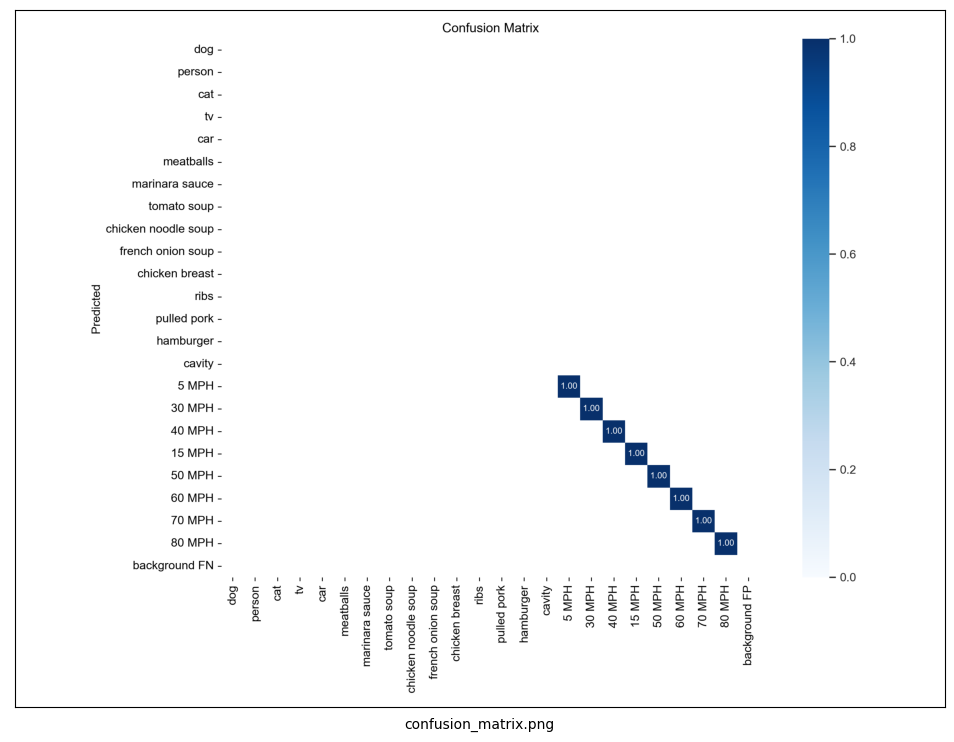

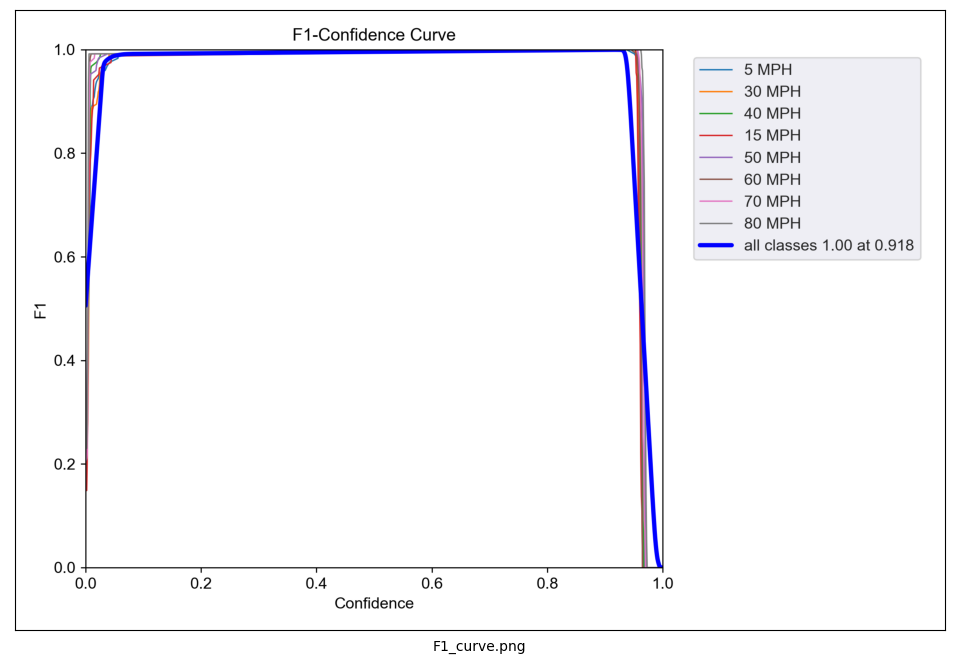

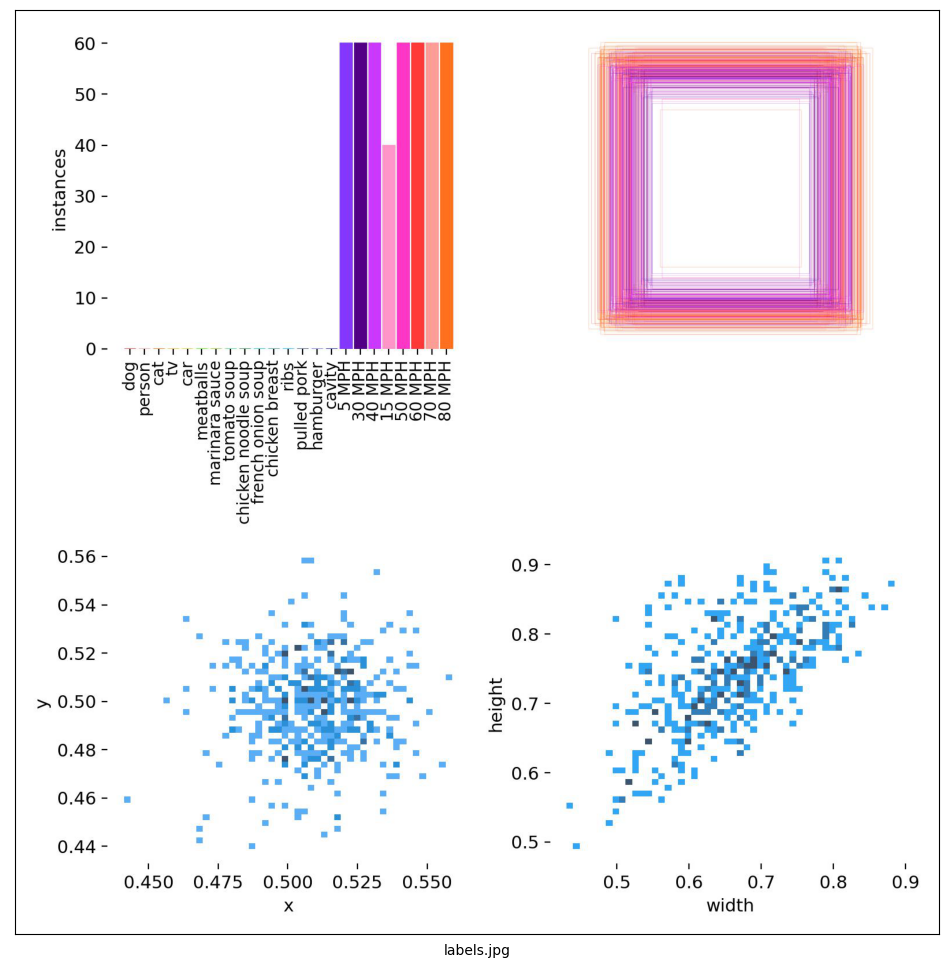

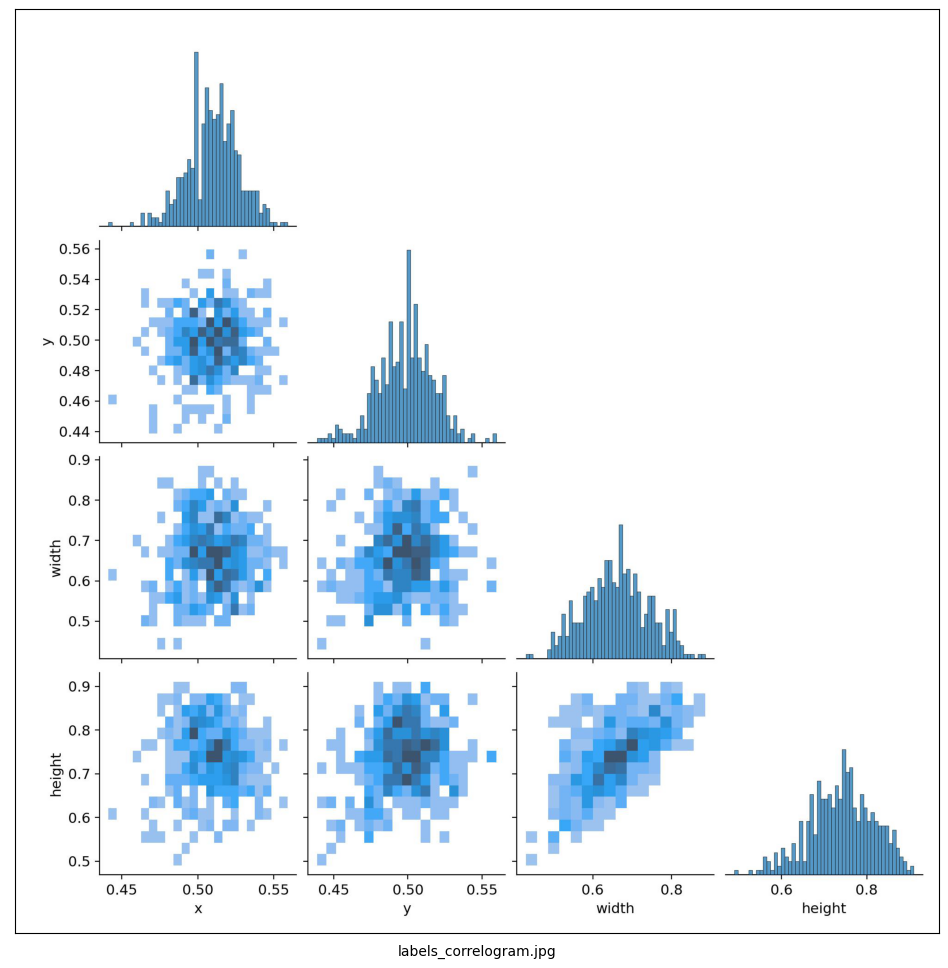

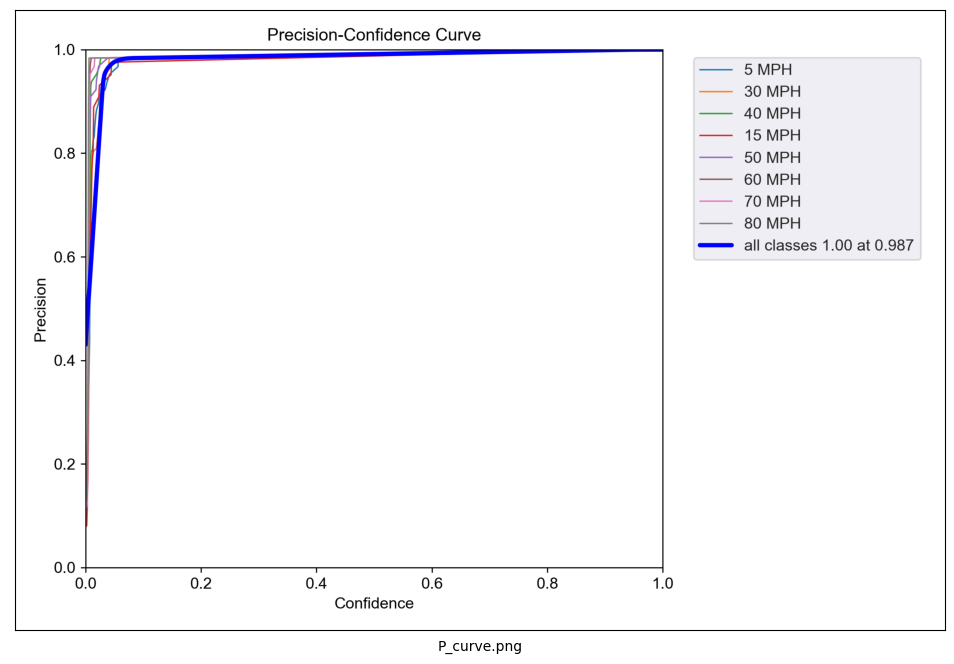

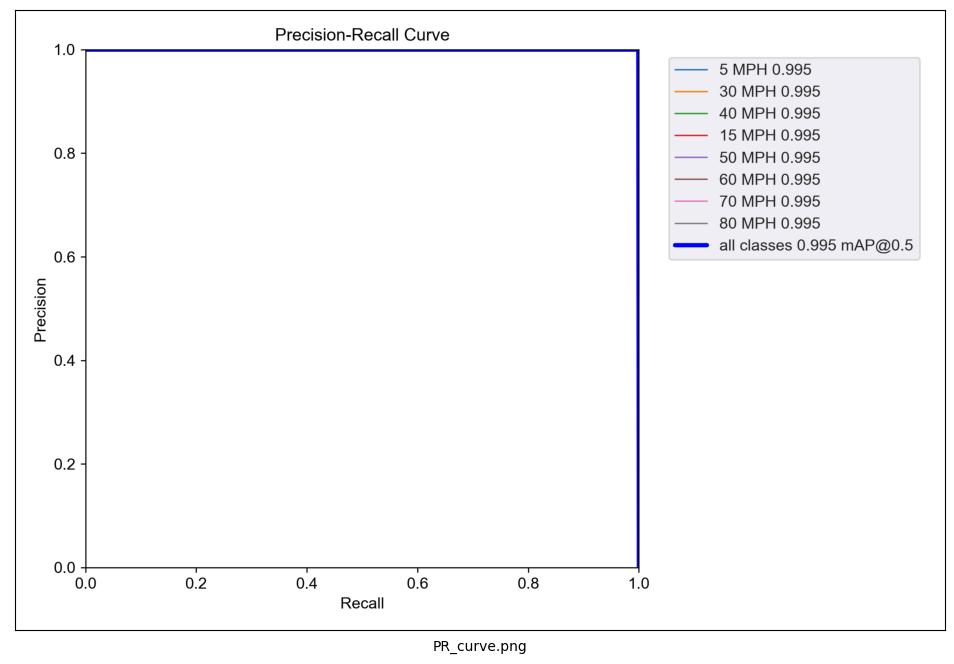

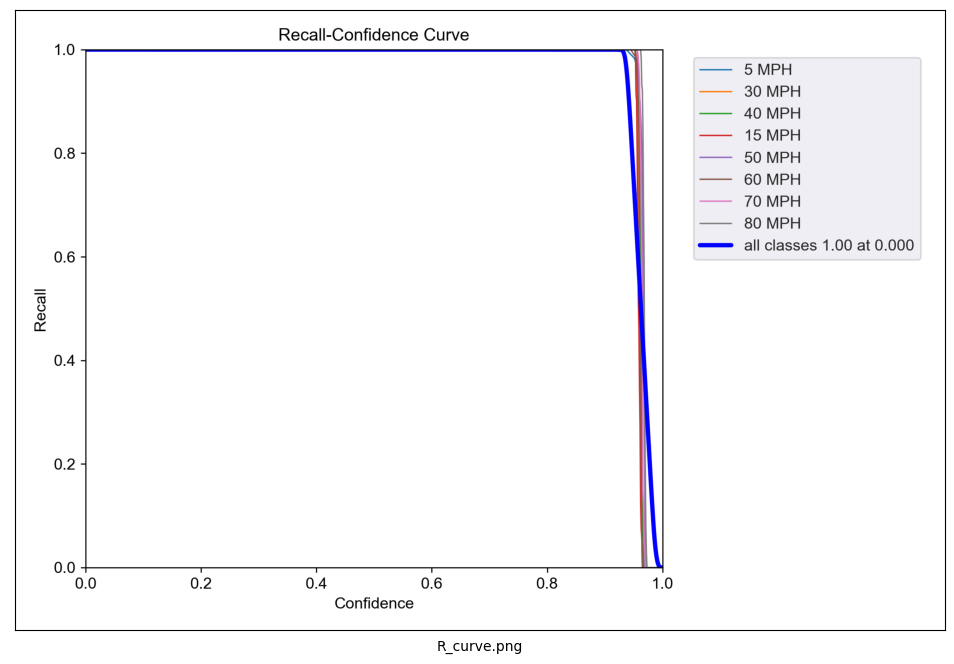

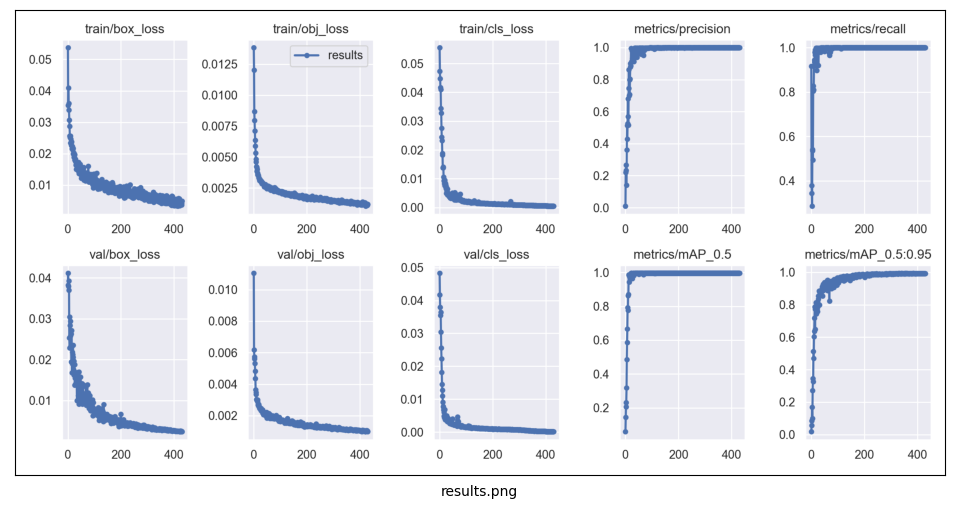

In [7]:
import matplotlib.pyplot as plt
%matplotlib inline

for i in range (len(graphs)):
    plt.figure(figsize=(12, 12))
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.xlabel(graphs[i])
    plt.imshow(plt.imread(os.path.join(exp_dir, graphs[i])))
    plt.show()

As you can see from the graphs the model achieved great results

<b>One thing to improve:</b> I used the same training set as a validation set. it could have been better if I used a seperate set for validation

But the model will be tested thoroughly using online images that the model has not seen before.

# Model testing<hr style="height:5px">

### lets grap some online images to test the model on:

In [8]:
test_data = ['https://startsafety.uk/image/catalog/product-photos/signs/speed-limit-sign-post-mount/r2-speed-signs/5mph-installed-at-a-school-inline.jpg',
            'https://st.depositphotos.com/1001564/2399/i/600/depositphotos_23995185-stock-photo-speed-limit-traffic-sign.jpg',
            'https://thumbs.dreamstime.com/b/speed-limit-orange-road-sign-country-210436233.jpg',
            'https://c8.alamy.com/comp/2E5ADH2/australians-80-km-per-hour-speed-limit-sign-on-side-of-road-2E5ADH2.jpg',
            'https://motorbikewriter.com/wp-content/uploads/2017/01/60-a.jpg',
            'https://c8.alamy.com/comp/2CBGN4C/30-mph-speed-limit-board-on-uk-roads-2CBGN4C.jpg',
            'https://signs2schools.co.uk/wp-content/uploads/5mph-speed-limit-sign-fitting-requirements-400mm-x-266mm-2.5m-aluminium-post-1751-p.jpg',
            'http://www.signspotters.hobbiesplus.com.au/P1010054.JPG',
            'https://images.perthnow.com.au/publication/C-881839/69c02bf5ee69c6bef372a21020f9f4d1525ece7b.jpg?imwidth=668&impolicy=pn_v3',
            'https://content.api.news/v3/images/bin/f7ce41b11ec4890676538938791b0312',
            'https://api.brusselstimes.com/wp-content/uploads/2020/04/zone30belga.jpg',
            'https://c8.alamy.com/comp/G1JYA8/5-mph-5mph-maximum-speed-limit-sign-uk-beware-pedestrians-sign-signs-G1JYA8.jpg',
            'https://startsafety.uk/image/catalog/product-photos/signs/speed-limit-sign-post-mount/r2-speed-signs/15mph-speed-limit-sign-inline.jpg',
            'https://www.driverknowledgetests.com/resources/wp-content/uploads/2014/05/15kph-sign-300x207.jpg',
            'https://c8.alamy.com/comp/APMEH7/70mph-road-sign-on-the-m77near-kilmarnock-central-scotland-2006-APMEH7.jpg',
            'https://media.istockphoto.com/photos/speed-limit-sign-picture-id848684230?k=20&m=848684230&s=612x612&w=0&h=SawIPMXoLhomGAHM_4k_sreGRZRIwITuCCx83q-fK_A=',
            'https://l450v.alamy.com/450v/k1apdj/big-truck-passing-on-high-speed-on-the-road-commenting-an-infraction-k1apdj.jpg',
            'https://www.redlandcitybulletin.com.au/images/transform/v1/crop/frm/silverstone-feed-data/4d8a075f-fd28-440f-8edc-da6e49c0f1c6.JPG/r0_0_3264_2448_w1200_h678_fmax.jpg',
            'https://lh3.googleusercontent.com/DOZ16QmMgjqUTnArR_4EnnYdeNIzfRu4YOVLXtgShEzOGcVBZq-GRL136vc7Vrxww02Gk2A5kv2sT1eLAcOCoOrujTVeraYqXl5CxNCSdgcjMA=s750',
            'https://c8.alamy.com/comp/2BN02K9/beautiful-close-up-photo-of-fresh-60-km-speed-limit-traffic-sign-mounted-on-black-pole-blurry-background-with-one-car-and-truck-driving-on-leading-to-2BN02K9.jpg',
            'https://c8.alamy.com/comp/2GDAYGF/close-up-of-old-orange-peeling-sign-in-very-rough-condition-speed-limit-sign-temporary-sign-of-road-works-caution-warning-dents-and-holes-in-the-2GDAYGF.jpg',
            'https://b.rgbimg.com/users/s/su/sundstrom/600/mif4JKc.jpg',
            'https://img.freepik.com/premium-photo/traffic-sign-speed-limit-40-mph_99433-3146.jpg?w=2000',
            'https://c8.alamy.com/comp/BT370H/a-15-mph-speed-limit-traffic-sign-against-an-overcast-grey-sky-BT370H.jpg']

In [9]:
to_improve = ['https://images.perthnow.com.au/publication/C-881839/c91c9e48d58c0f4b2384a134e7ffa1fc1d6bf3b9-4x3-x103y0w880h661.jpg',
             'https://media.istockphoto.com/photos/speed-limit-sign-picture-id541997460?k=20&m=541997460&s=612x612&w=0&h=yrAeKNrCW5e9jvk5JtvqyM5v6ptO6hc09GawKRPvp6E=',
             'https://www.independent.ie/regionals/enniscorthyguardian/news/9929a/38964706.ece/AUTOCROP/w1240h700/2020-02-18_wex_56939508_I1.JPG',
             'https://media.istockphoto.com/photos/do-not-enter-no-stopping-and-speed-limit-traffic-signs-picture-id471838148?s=2048x2048',
             'https://img.etimg.com/thumb/msid-83426662,width-1200,height-900,imgsize-175859,overlay-economictimes/photo.jpg']

In [10]:
import numpy as np
import torch

In [11]:
model = torch.hub.load("ultralytics/yolov5", 'custom', path=os.path.join(exp_dir, 'weights/best.pt'), force_reload=True)

Downloading: "https://github.com/ultralytics/yolov5/zipball/master" to C:\Users\xegah/.cache\torch\hub\master.zip
YOLOv5  2022-9-26 Python-3.9.13 torch-1.12.1 CUDA:0 (NVIDIA GeForce GTX 1650, 4096MiB)

Fusing layers... 
Model summary: 213 layers, 7072156 parameters, 0 gradients, 15.9 GFLOPs
Adding AutoShape... 


In [12]:
len(test_data)

24

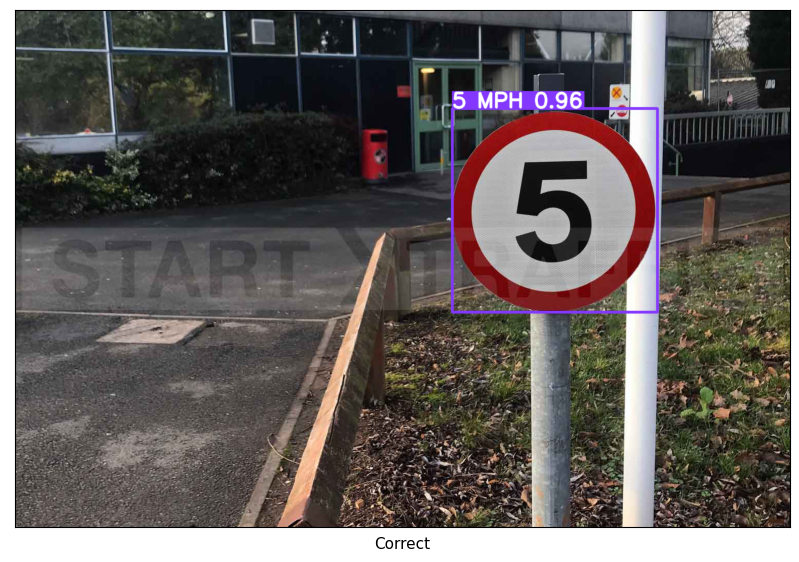

image 1/1: 1000x1500 1 5 MPH
Speed: 1760.3ms pre-process, 66.0ms inference, 55.5ms NMS per image at shape (1, 3, 448, 640)


None


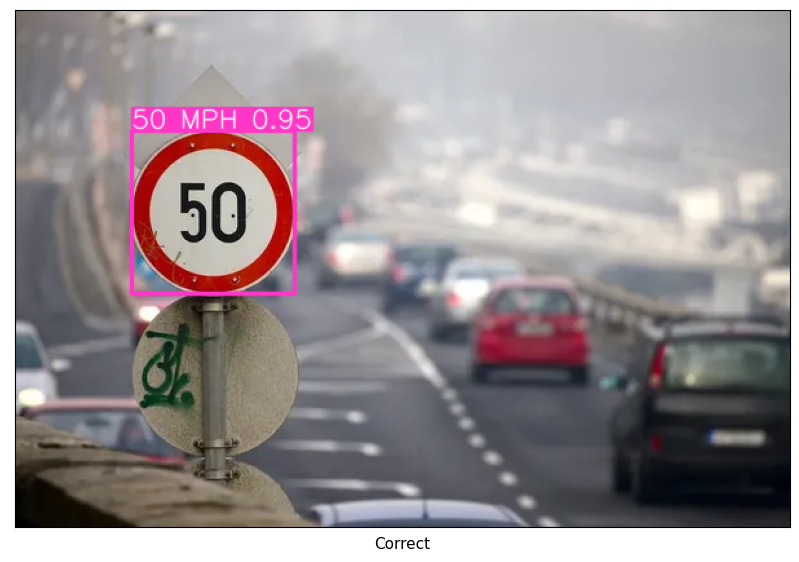

image 1/1: 400x600 1 50 MPH
Speed: 980.4ms pre-process, 84.0ms inference, 3.8ms NMS per image at shape (1, 3, 448, 640)


None


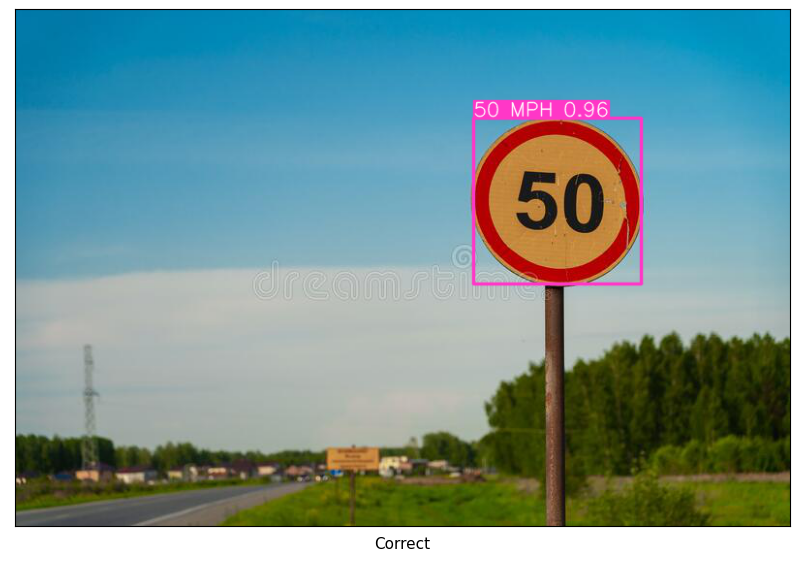

image 1/1: 533x800 1 50 MPH
Speed: 624.2ms pre-process, 82.5ms inference, 2.3ms NMS per image at shape (1, 3, 448, 640)


None


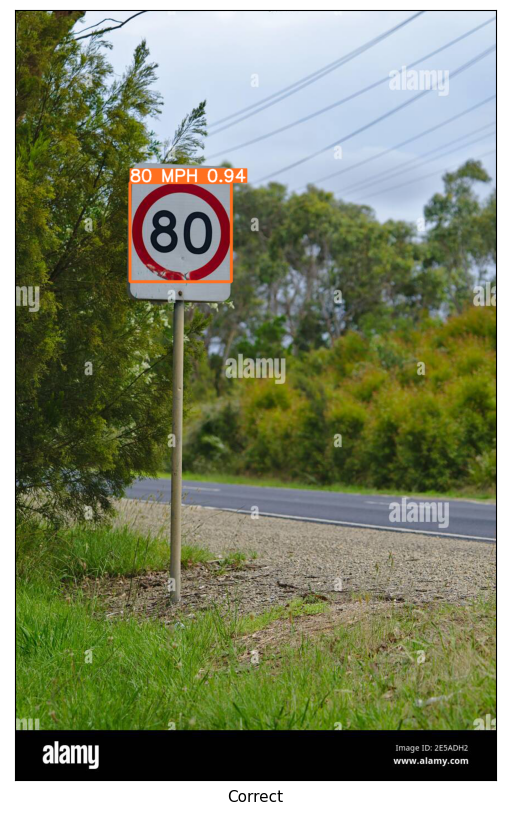

image 1/1: 1390x868 1 80 MPH
Speed: 2826.1ms pre-process, 122.5ms inference, 3.8ms NMS per image at shape (1, 3, 640, 416)


None


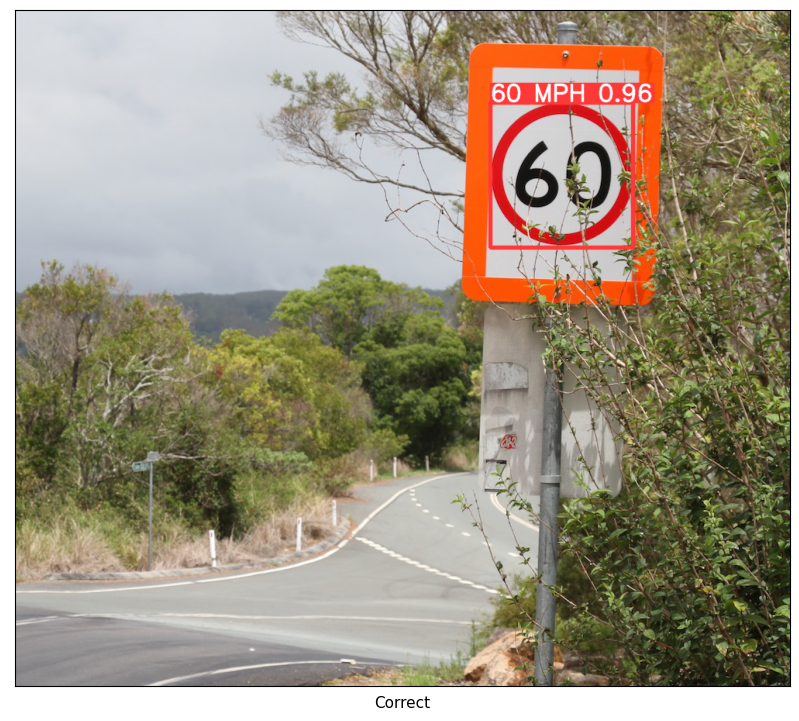

image 1/1: 872x1000 1 60 MPH
Speed: 2039.0ms pre-process, 159.8ms inference, 2.3ms NMS per image at shape (1, 3, 576, 640)


None


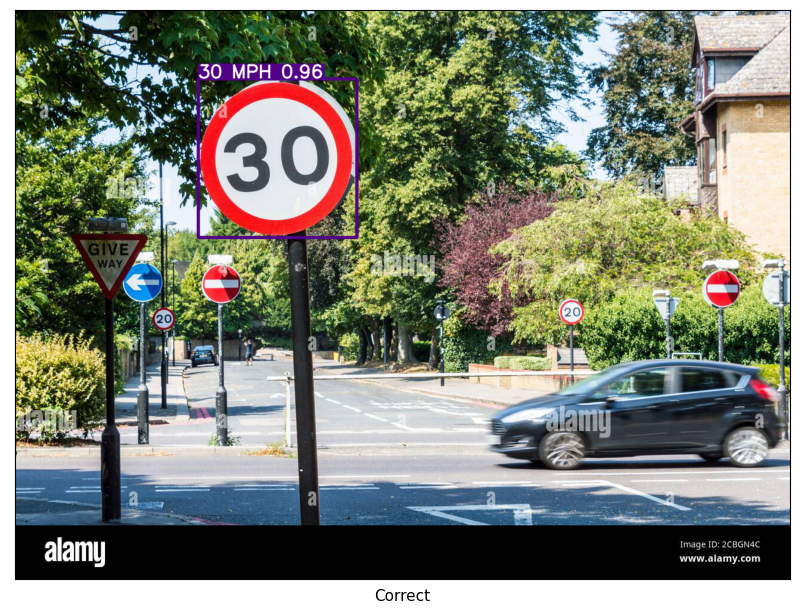

image 1/1: 954x1300 1 30 MPH
Speed: 3129.4ms pre-process, 133.0ms inference, 3.0ms NMS per image at shape (1, 3, 480, 640)


None


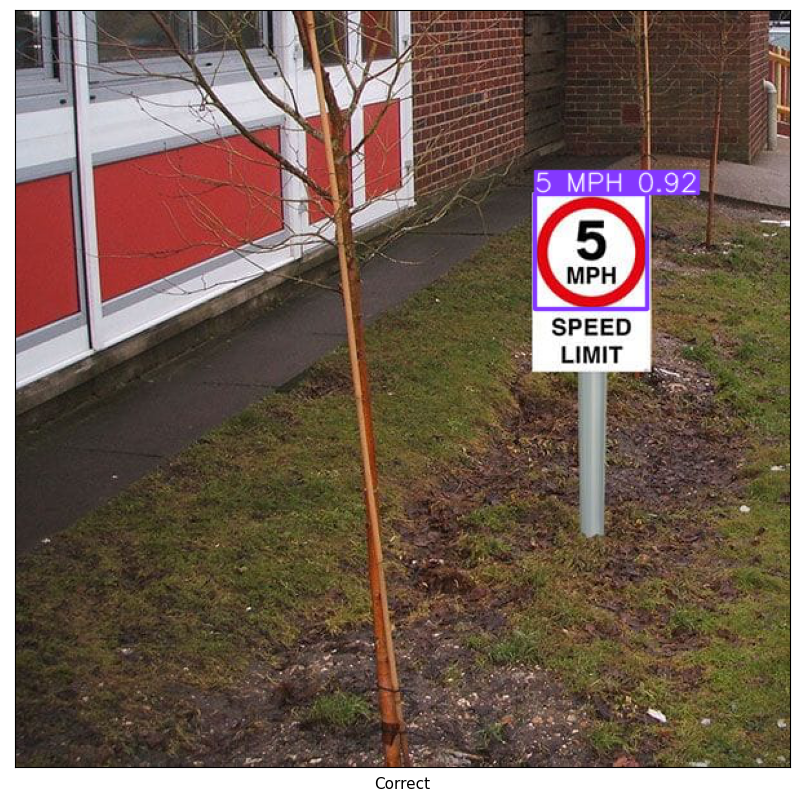

image 1/1: 586x600 1 5 MPH
Speed: 1031.0ms pre-process, 130.5ms inference, 1.4ms NMS per image at shape (1, 3, 640, 640)


None


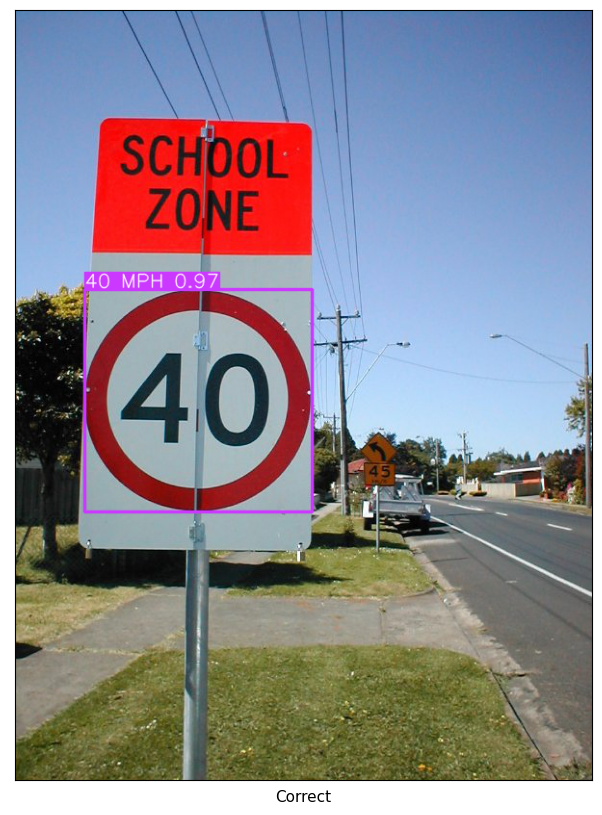

image 1/1: 800x600 1 40 MPH
Speed: 1916.0ms pre-process, 133.5ms inference, 2.8ms NMS per image at shape (1, 3, 640, 480)


None


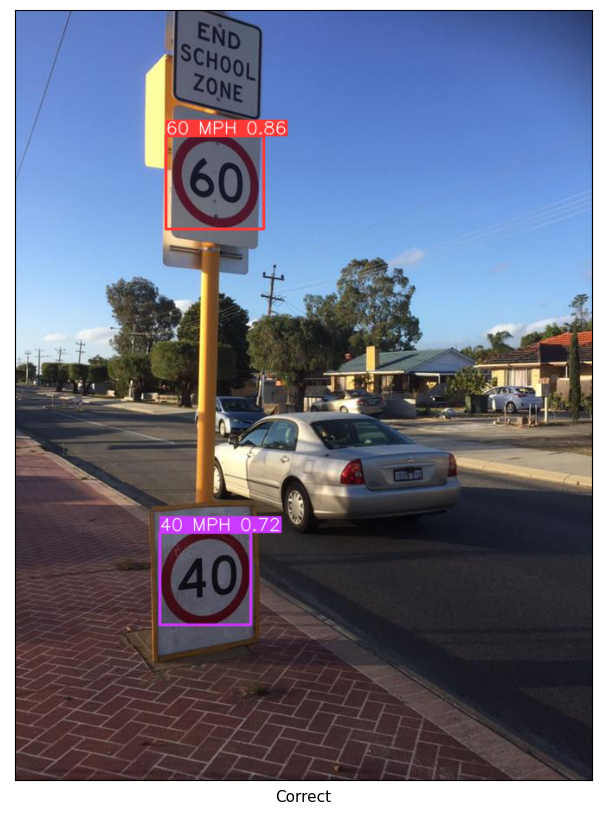

image 1/1: 891x668 1 40 MPH, 1 60 MPH
Speed: 893.0ms pre-process, 129.0ms inference, 10.5ms NMS per image at shape (1, 3, 640, 480)


None


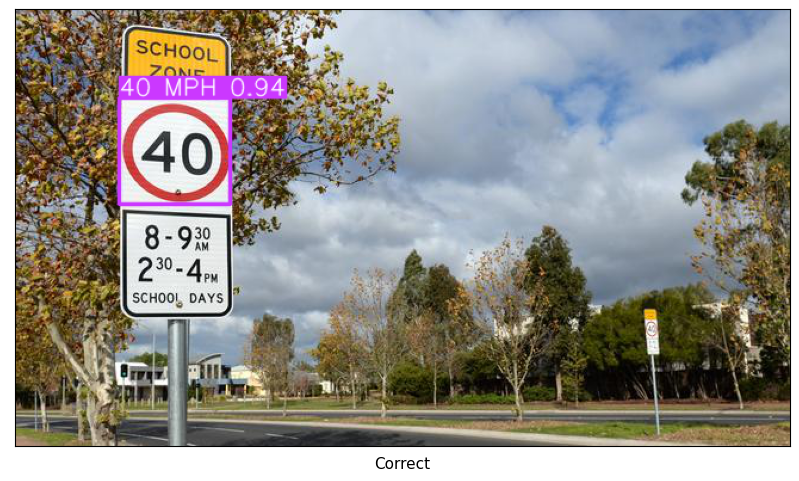

image 1/1: 366x650 1 40 MPH
Speed: 1012.1ms pre-process, 80.1ms inference, 5.2ms NMS per image at shape (1, 3, 384, 640)


None


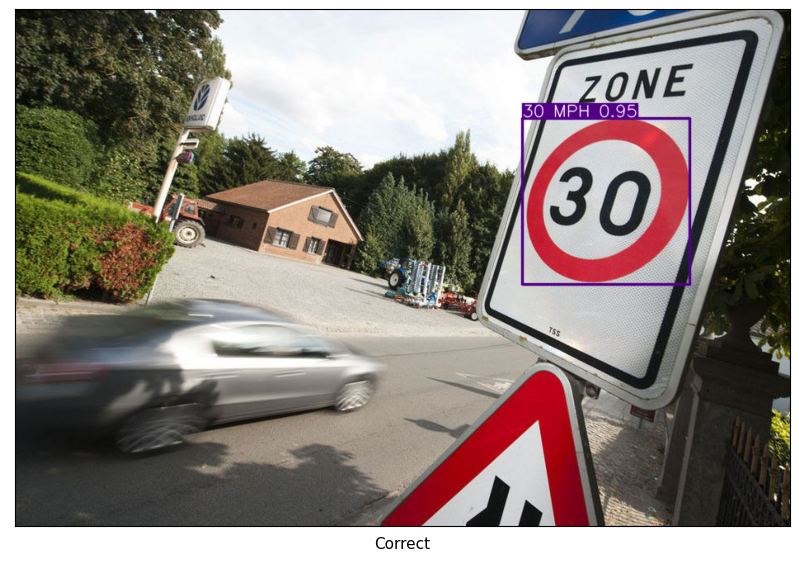

image 1/1: 626x940 1 30 MPH
Speed: 1110.5ms pre-process, 126.8ms inference, 1.7ms NMS per image at shape (1, 3, 448, 640)


None


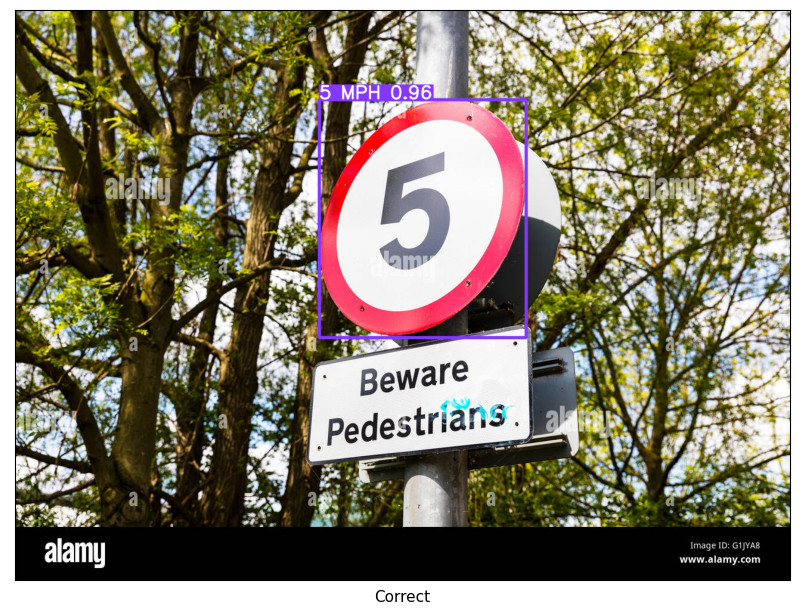

image 1/1: 956x1300 1 5 MPH
Speed: 3549.6ms pre-process, 133.1ms inference, 3.0ms NMS per image at shape (1, 3, 480, 640)


None


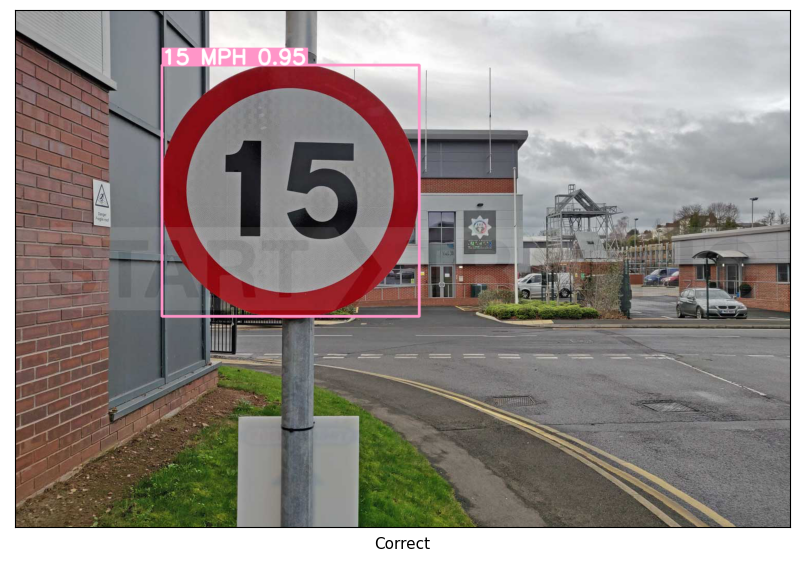

image 1/1: 1000x1500 1 15 MPH
Speed: 1256.3ms pre-process, 127.5ms inference, 2.3ms NMS per image at shape (1, 3, 448, 640)


None


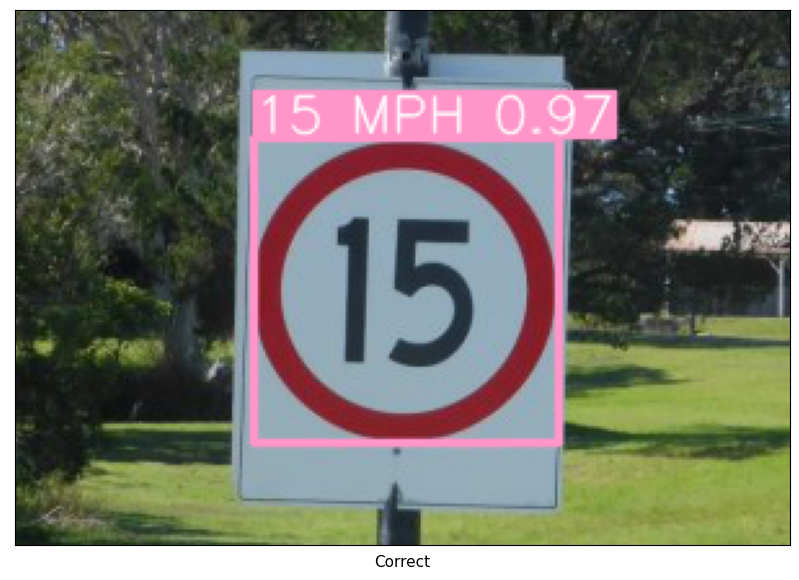

image 1/1: 207x300 1 15 MPH
Speed: 21999.1ms pre-process, 128.3ms inference, 2.8ms NMS per image at shape (1, 3, 448, 640)


None


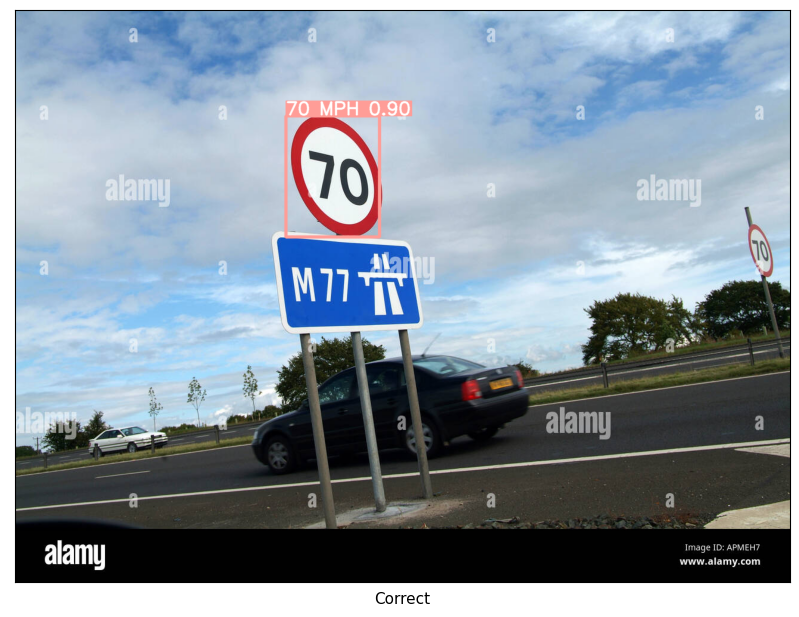

image 1/1: 959x1300 1 70 MPH
Speed: 2174.6ms pre-process, 129.0ms inference, 1.6ms NMS per image at shape (1, 3, 480, 640)


None


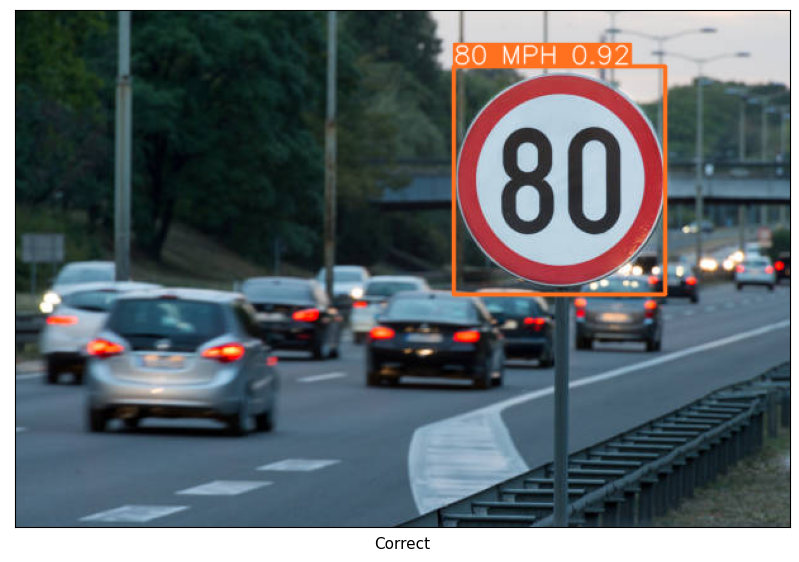

image 1/1: 408x612 1 80 MPH
Speed: 697.6ms pre-process, 84.9ms inference, 4.4ms NMS per image at shape (1, 3, 448, 640)


None


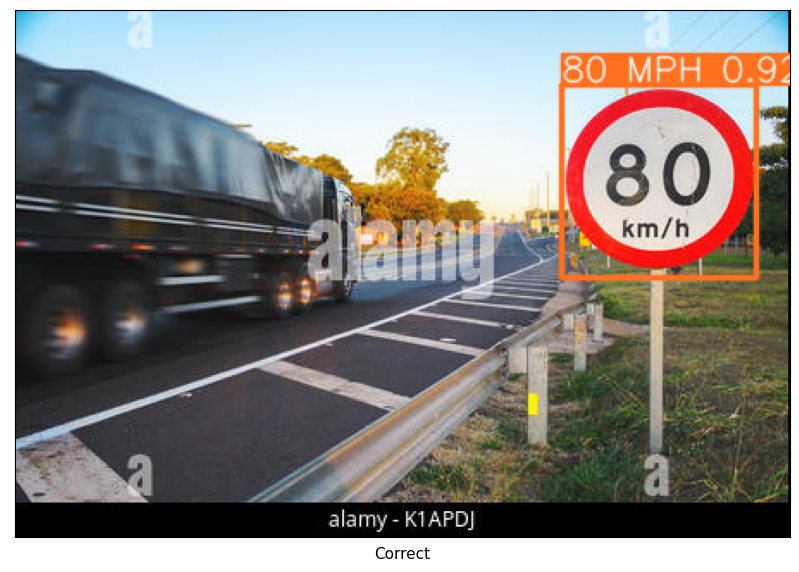

image 1/1: 306x450 1 80 MPH
Speed: 1470.3ms pre-process, 123.1ms inference, 2.2ms NMS per image at shape (1, 3, 448, 640)


None


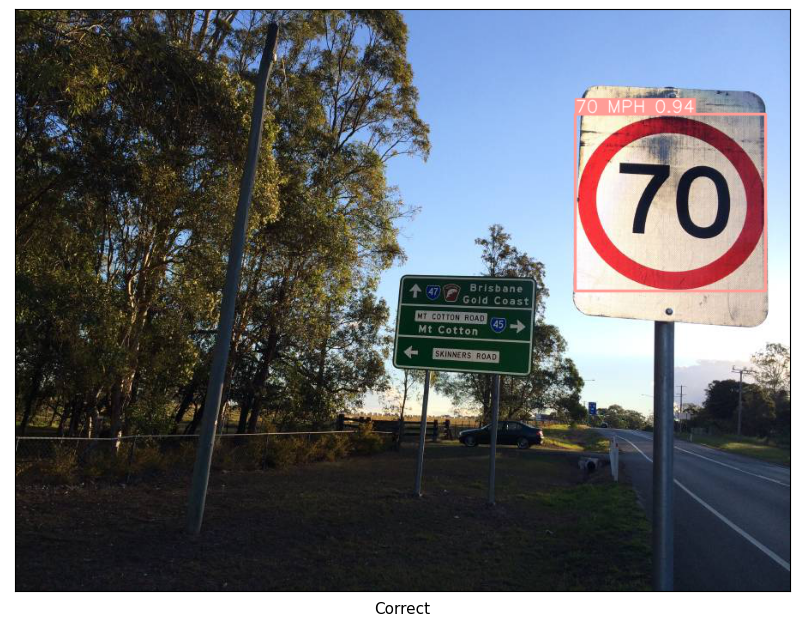

image 1/1: 678x904 1 70 MPH
Speed: 1070.4ms pre-process, 91.5ms inference, 3.0ms NMS per image at shape (1, 3, 480, 640)


None


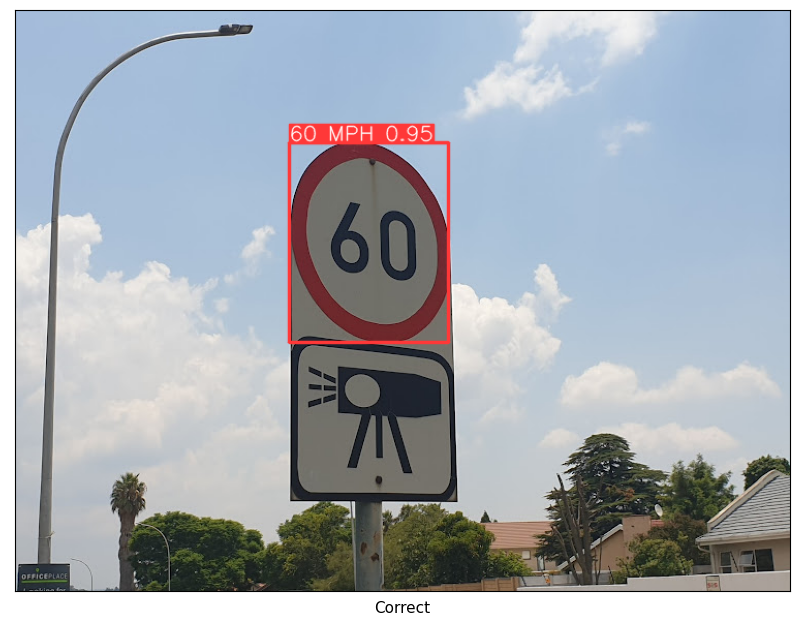

image 1/1: 562x750 1 60 MPH
Speed: 846.8ms pre-process, 87.0ms inference, 2.3ms NMS per image at shape (1, 3, 480, 640)


None


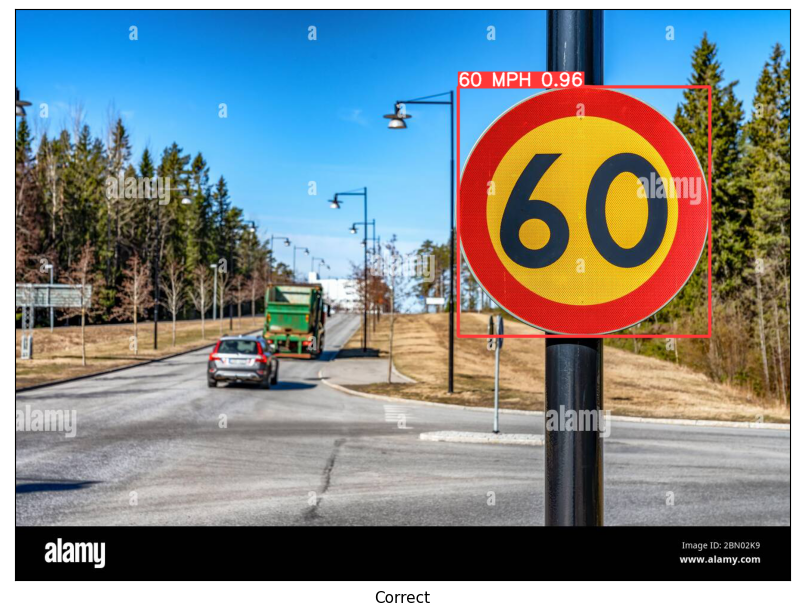

image 1/1: 957x1300 1 60 MPH
Speed: 2468.6ms pre-process, 128.3ms inference, 4.5ms NMS per image at shape (1, 3, 480, 640)


None


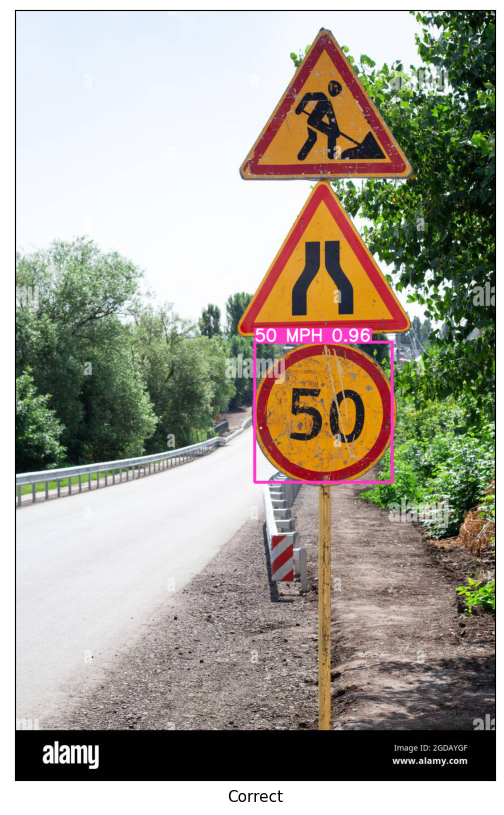

image 1/1: 1390x866 1 50 MPH
Speed: 2806.2ms pre-process, 118.5ms inference, 2.3ms NMS per image at shape (1, 3, 640, 416)


None


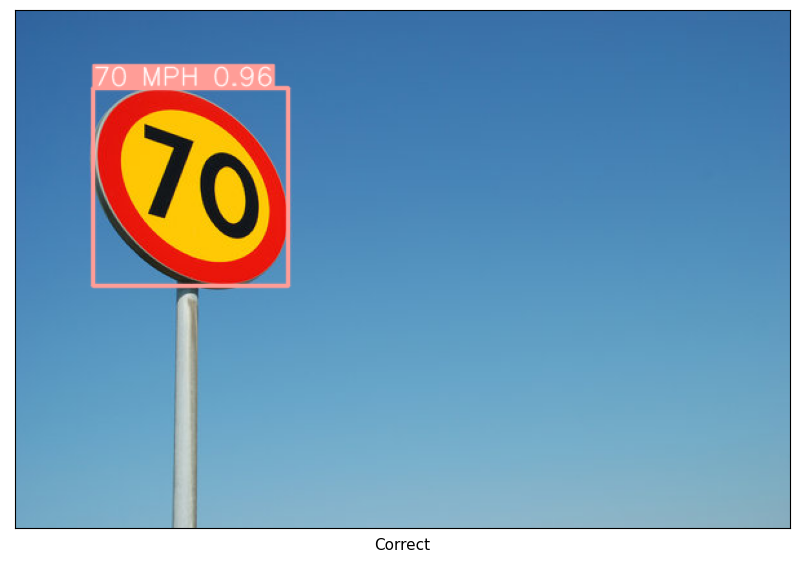

image 1/1: 401x600 1 70 MPH
Speed: 665.8ms pre-process, 84.8ms inference, 3.0ms NMS per image at shape (1, 3, 448, 640)


None


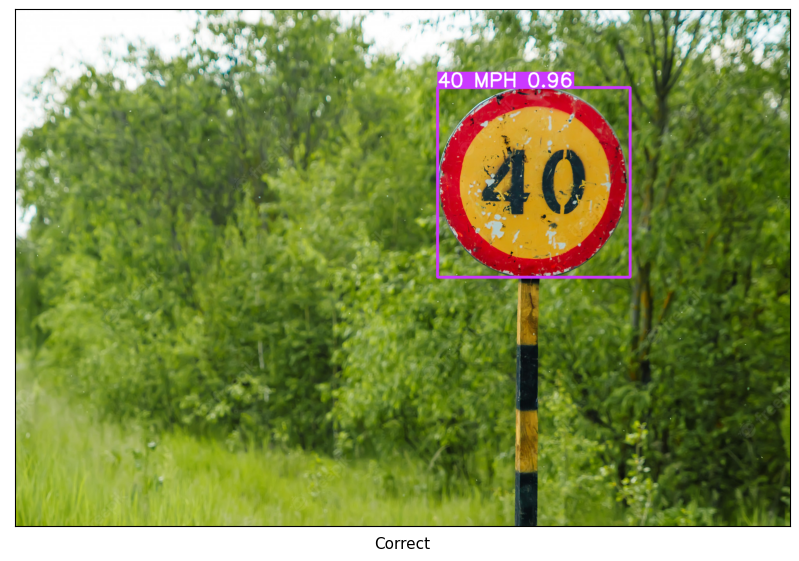

image 1/1: 1333x2000 1 40 MPH
Speed: 3155.4ms pre-process, 123.0ms inference, 2.3ms NMS per image at shape (1, 3, 448, 640)


None


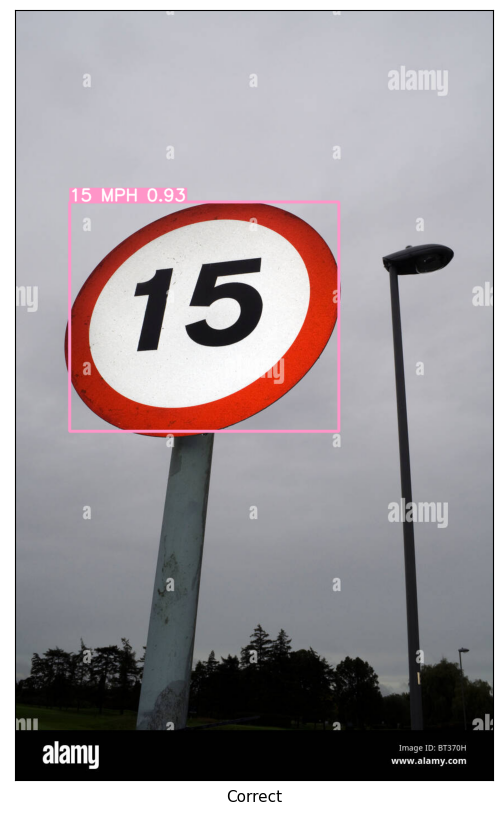

image 1/1: 1390x863 1 15 MPH
Speed: 2099.0ms pre-process, 118.5ms inference, 2.3ms NMS per image at shape (1, 3, 640, 416)


None


In [13]:
%matplotlib inline
for i in range(len(test_data)):
    results = model(test_data[i])
    plt.figure(figsize=(10, 10))
    plt.xticks([])
    plt.yticks([])
    plt.xlabel('Correct')
    plt.imshow(np.squeeze(results.render()))
    plt.show()
    print(results.print())

In [14]:
comments = ['The sign is too far away', 'The sign is too far away', 'The 50 sign is far away',
            'The signs were not included in the training data', 'The signs were not included in the training data']

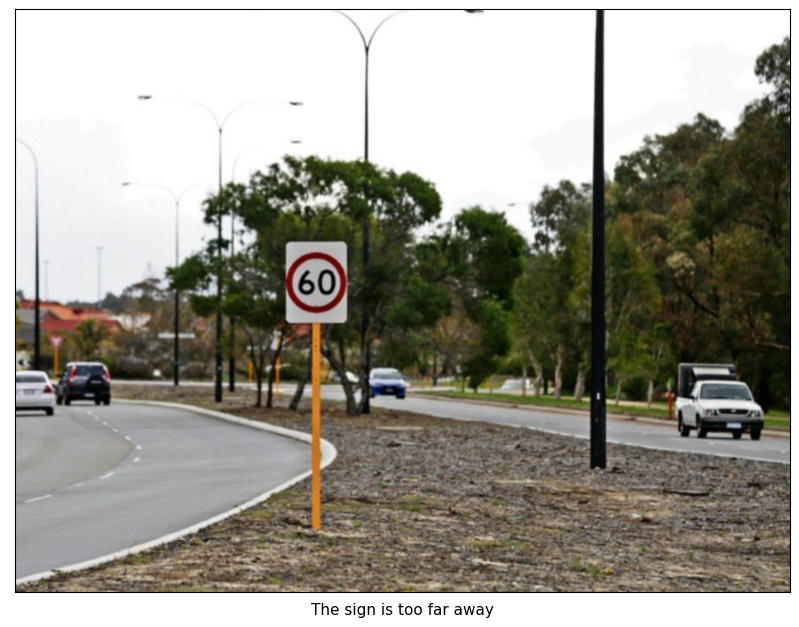

image 1/1: 661x880 (no detections)
Speed: 863.8ms pre-process, 100.5ms inference, 0.8ms NMS per image at shape (1, 3, 512, 640)


None


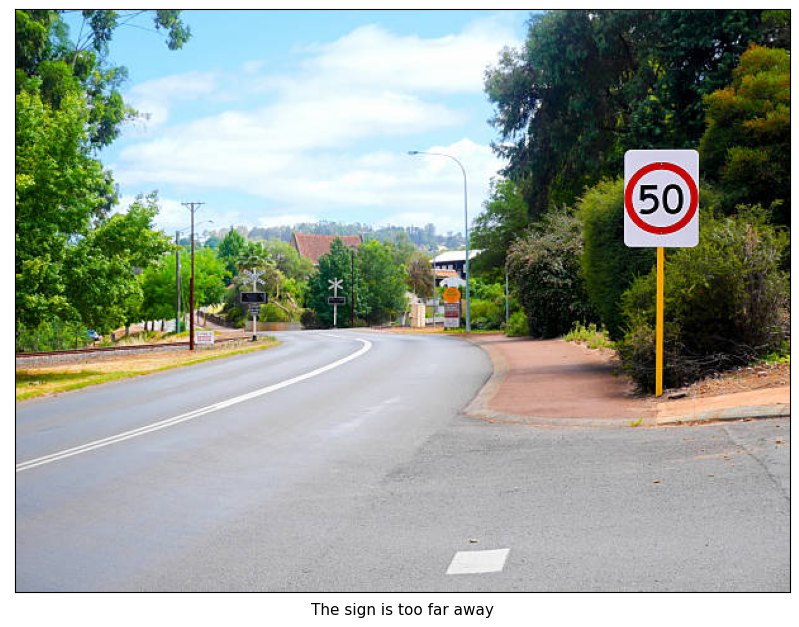

image 1/1: 460x612 (no detections)
Speed: 770.6ms pre-process, 95.3ms inference, 2.3ms NMS per image at shape (1, 3, 512, 640)


None


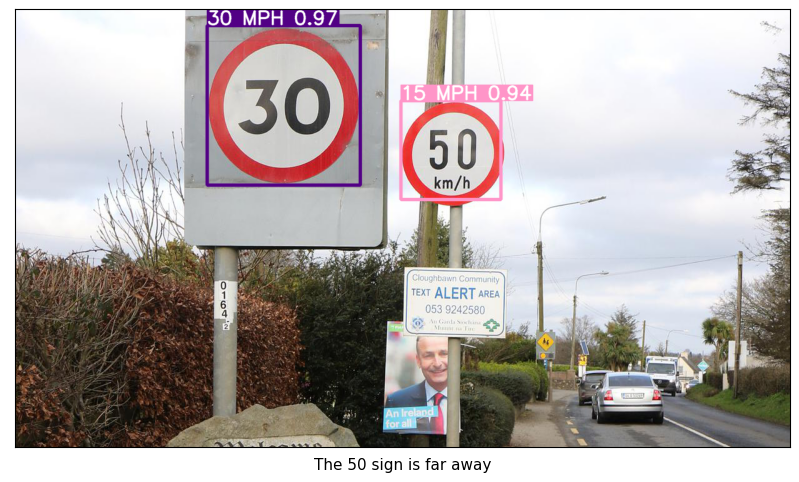

image 1/1: 700x1240 1 30 MPH, 1 15 MPH
Speed: 1210.6ms pre-process, 68.3ms inference, 3.0ms NMS per image at shape (1, 3, 384, 640)


None


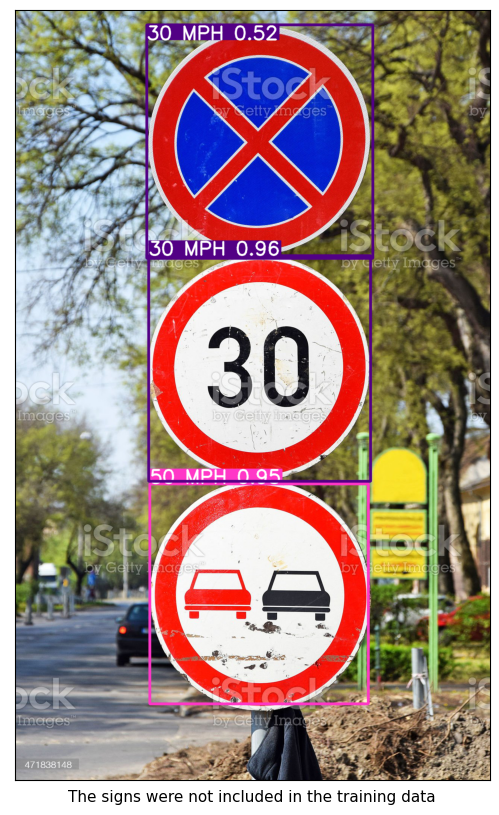

image 1/1: 2048x1263 2 30 MPHs, 1 50 MPH
Speed: 3166.0ms pre-process, 118.6ms inference, 3.0ms NMS per image at shape (1, 3, 640, 416)


None


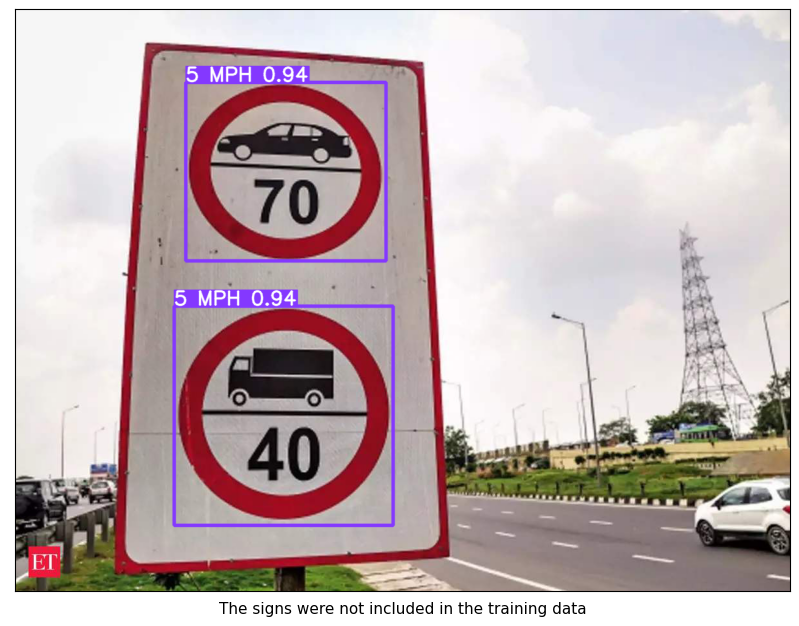

image 1/1: 900x1200 2 5 MPHs
Speed: 882.2ms pre-process, 123.9ms inference, 2.3ms NMS per image at shape (1, 3, 480, 640)


None


In [15]:
for i in range(len(to_improve)):
    results = model(to_improve[i])
    plt.figure(figsize=(10, 10))
    plt.xticks([])
    plt.yticks([])
    plt.xlabel(comments[i])
    plt.imshow(np.squeeze(results.render()))
    plt.show()
    print(results.print())

# Conclusion<hr style="height:5px">

The model can detect every and each class correctly without mistaking the classes for one another when the sign is in close to medium proximity of the camera or taking a substantial area of the frame.
That is logical as all the images in the traning set have the sign large and centered in the frame.
The model can detect correctly signs where the background is yellow or a sign with a small word written below the number such as: MPH or km/h even though the training data didn't have them. 
It can also detect correctly signs that are not clear or rusty and the numbers are not visible clearly or there is an object covering a portion of the sign, as long as the sign isn't far away.


The model begins to show its weaknesses when tested with far away sign or signs that were not present in the traning data set.

# Recommendations<hr style="height:5px">

Adding more images where the signs are small or far away in the frame
Adding more classes with other traffic signs 

In the next notebook I will make real time predictions using our model and cv2

<b>Thank you,</b> <br>
<b>Mustafa Megahed</b>